In [1]:
import pandas as pd
import numpy as np
import pandas_profiling
from scipy.stats import mode
import scipy as sc
import seaborn as sns #visualisation
import matplotlib.pyplot as plt #visualisation
%matplotlib inline 
sns.set(color_codes=True)
import tensorflow as tf
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler

In [2]:
#To force pyhton to show all output instead of the last output only
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [62]:
#Read the csv file
cust_df = pd.read_csv('Customer_Dataset_File.csv')
cust_df.head(3)

,CustomerID,Region,TownSize,Gender,Age,EducationYears,JobCategory,UnionMember,EmploymentLength,Retired,...,CallWait,CallForward,ThreeWayCalling,EBilling,TVWatchingHours,OwnsPC,OwnsMobileDevice,OwnsGameSystem,OwnsFax,NewsSubscriber
0,3964-QJWTRG-NPN,1,2,Female,20,15,Professional,Yes,0,No,...,Yes,Yes,Yes,No,13,No,Yes,Yes,No,No
1,0648-AIPJSP-UVM,5,5,Male,22,17,Sales,No,0,No,...,No,Yes,No,Yes,18,Yes,Yes,Yes,Yes,Yes
2,5195-TLUDJE-HVO,3,4,Female,67,14,Sales,No,16,No,...,No,No,No,No,21,No,No,No,No,Yes


In [6]:
#Dimensions of the data and investigate if there are any duplicate rows
cust_df.shape
print(f'There are {cust_df.shape[0]} rows and {cust_df.shape[1]} columns in the customer dataframe')

(5000, 59)

There are 5000 rows and 59 columns in the customer dataframe


In [121]:
cust_df.describe(include='object')

,CustomerID,TownSize,Gender,JobCategory,UnionMember,Retired,HHIncome,LoanDefault,MaritalStatus,CarOwnership,...,CallerID,CallWait,CallForward,ThreeWayCalling,EBilling,OwnsPC,OwnsMobileDevice,OwnsGameSystem,OwnsFax,NewsSubscriber
count,5000,5000,4967,4985,5000,5000,5000,5000,5000,5000,...,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000
unique,5000,6,2,6,2,2,266,2,2,3,...,2,2,2,2,2,2,2,2,2,2
top,7772-UISXUF-OP9,1,Female,Sales,0,0,"$22,000.00",0,Unmarried,Own,...,0,0,0,0,0,1,0,0,0,0
freq,1,1436,2494,1635,4244,4262,112,3829,2599,3704,...,2624,2605,2597,2610,3257,3164,2604,2626,4106,2637


In [7]:
#Rows containing duplicate data
duplicate_rows_cust_df = cust_df[cust_df.duplicated()]
print('number of duplicate rows:', duplicate_rows_cust_df.shape)
print(f'There are {len(duplicate_rows_cust_df)} number of duplicate rows')
duplicate_rows_cust_df.shape

number of duplicate rows: (0, 59)
There are 0 number of duplicate rows


(0, 59)

In [14]:
# Finding the null values for each column
cols = cust_df.columns
nullcheck = cust_df.isnull().sum()
for i,e in enumerate(nullcheck):   
    if e != 0:
        print(cols[i],e)

Gender 33
JobCategory 15
HouseholdSize 8
NumberPets 6
NumberCats 7
NumberDogs 8
NumberBirds 34
HomeOwner 13


In [15]:
cust_df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 59 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   CustomerID           5000 non-null   object 
 1   Region               5000 non-null   int64  
 2   TownSize             5000 non-null   object 
 3   Gender               4967 non-null   object 
 4   Age                  5000 non-null   int64  
 5   EducationYears       5000 non-null   int64  
 6   JobCategory          4985 non-null   object 
 7   UnionMember          5000 non-null   object 
 8   EmploymentLength     5000 non-null   int64  
 9   Retired              5000 non-null   object 
 10  HHIncome             5000 non-null   object 
 11  DebtToIncomeRatio    5000 non-null   float64
 12  CreditDebt           5000 non-null   float64
 13  OtherDebt            5000 non-null   float64
 14  LoanDefault          5000 non-null   object 
 15  MaritalStatus        5000 non-null   o

In [16]:
pandas_profiling.ProfileReport(cust_df)

In [25]:
cust_df['HouseholdSize'].fillna(mode(cust_df['HouseholdSize']).mode[0], inplace=True)                                                
print(cust_df['HouseholdSize'].isnull().sum())
#Replace missing character values with the mode of the distribution 
cust_df['JobCategory'].fillna(mode(cust_df['JobCategory']).mode[0], inplace=True)

0


## EDA Analysis

In [95]:
edadf = pd.DataFrame(cust_df)
edadf.replace({'No': 0, 'Yes': 1}, inplace=True)
edadf.replace({False: 0, True: 1}, inplace=True)
edadf.replace({'Female': 0, 'Male': 1}, inplace=True)
edadf.replace({'Unmarried': 0, 'Married': 1}, inplace=True)
edadf.describe(include = 'object')

,CustomerID,TownSize,JobCategory,HHIncome,CarOwnership,CarBrand,CarValue,CommuteTime,CreditCard,CardSpendMonth,VoiceLastMonth,VoiceOverTenure,EquipmentLastMonth,EquipmentOverTenure,DataLastMonth,DataOverTenure,Internet
count,5000,5000,4985,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000,5000
unique,5000,6,6,266,3,3,801,42,5,4760,866,4438,735,1683,746,1328,5
top,7772-UISXUF-OP9,1,Sales,"$22,000.00",Own,Domestic,"$(1,000.00)",24,Disc,$-,$12.60,$2.05,$-,$-,$-,$-,0
freq,1,1436,1635,112,3704,2287,497,336,1344,7,31,8,3296,3296,3656,3656,2498


In [96]:

currencies = ['HHIncome', 'CardSpendMonth','CarValue','VoiceLastMonth','VoiceOverTenure', 'EquipmentLastMonth',
              'EquipmentOverTenure','DataLastMonth','DataOverTenure']
for col in currencies:
    edadf[col] = edadf[col].apply(clean_currency).astype('float')


edadf['CommuteTime'] = edadf['CommuteTime'].apply(clean_currency).astype('float')
edadf['TownSize'] = edadf['TownSize'].apply(clean_currency).astype('float')

In [97]:
edadf = pd.get_dummies(edadf,columns = ['JobCategory','CarOwnership','CarBrand'])

In [98]:
edadf = edadf.drop(['CustomerID', 'CreditCard','Internet'],axis = 1)
edadf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 65 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Region                    5000 non-null   int64  
 1   TownSize                  5000 non-null   float64
 2   Gender                    4967 non-null   float64
 3   Age                       5000 non-null   int64  
 4   EducationYears            5000 non-null   int64  
 5   UnionMember               5000 non-null   int64  
 6   EmploymentLength          5000 non-null   int64  
 7   Retired                   5000 non-null   int64  
 8   HHIncome                  5000 non-null   float64
 9   DebtToIncomeRatio         5000 non-null   float64
 10  CreditDebt                5000 non-null   float64
 11  OtherDebt                 5000 non-null   float64
 12  LoanDefault               5000 non-null   int64  
 13  MaritalStatus             5000 non-null   int64  
 14  Househol

<Figure size 1440x576 with 0 Axes>

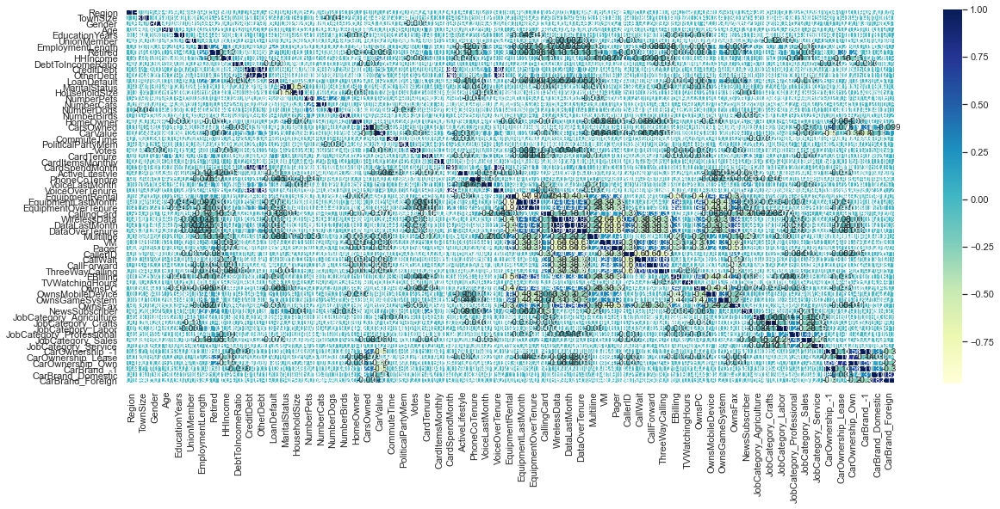

In [100]:
plt.figure(figsize=(20,8))

corr= edadf.apply(lambda x: pd.factorize(x)[0]).corr('spearman')
ax = sns.heatmap(corr, xticklabels = corr.columns, yticklabels = corr.columns,linewidths = .2, 
                 cmap = "YlGnBu", annot = True, annot_kws = {'size':10})
sns.set(font_scale = 1.25)

### Helper Methods & Feature Binning

In [85]:
def coding(col, codeDict):
    colCoded = pd.Series(col, copy=True)
    for key, value in codeDict.items():
        colCoded.replace(key, value, inplace=True)
    return colCoded

#Custom create function to clean variables with currency symbols
def clean_currency(x):
    """ If the value is a string, then remove currency symbol and delimiters
    otherwise, the value is numeric and can be converted
    """
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', '').replace('(','').replace(')','').replace('-','0.0').replace('#NULL!','0.0'))
    return(x)

#Binning continuous variables
def binning(col, cut_points, labels=None):
  #Define min and max values:
    minval = col.min()
    maxval = col.max()

    #create list by adding min and max to cut_points
    break_points = [minval] + cut_points + [maxval]
    print(break_points)  
    #if no labels provided, use default labels 0 ... (n-1)
    if not labels:
        labels = range(1,len(cut_points)+2)
        print(labels)
   #Binning using cut function of pandas
    colBin = pd.cut(col,bins=break_points,labels=labels,include_lowest=True)
    return colBin

In [23]:
cust_df['HHIncome'] = cust_df['HHIncome'].apply(clean_currency).astype('float')
print(cust_df['HHIncome'].dtype)
sc.mean(cust_df['HHIncome'])

float64


<ipython-input-23-f8f092b15f40>:3: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  sc.mean(cust_df['HHIncome'])


54759.6

In [24]:
#Recoding Gender as a numeric variable 
cust_df["Gender_num"] = coding(cust_df["Gender"], {'Female':1,'Male':0})
print ('\nAfter Coding:')
print (pd.value_counts(cust_df["Gender_num"]))


After Coding:
1.0    2494
0.0    2473
Name: Gender_num, dtype: int64


In [27]:
#Binning DebtToIncomeRatio:
cut_points = [5,10,15]
#labels = ["low","medium","high","very high"]
#cust_df["DebtToIncomeRatio_Recoded"] = binning(cust_df["DebtToIncomeRatio"], cut_points,labels)
#To get labels that start from 0 modify above range function; To use labels add labels in binning function below
cust_df["DebtToIncomeRatio_Recoded"] = binning(cust_df["DebtToIncomeRatio"], cut_points)
print (pd.value_counts(cust_df["DebtToIncomeRatio_Recoded"], sort=False))

[0.0, 5, 10, 15, 43.1]
range(1, 5)
1    1215
2    1662
3    1176
4     947
Name: DebtToIncomeRatio_Recoded, dtype: int64


In [28]:
#Binning Age:
cut_points = [31,47,62]
labels = ["18-31",">31-47",">47-62",">62"]
cust_df["Age_Recoded"] = binning(cust_df["Age"], cut_points,labels)
print (pd.value_counts(cust_df["Age_Recoded"], sort=False))

[18, 31, 47, 62, 79]
18-31     1253
>31-47    1322
>47-62    1187
>62       1238
Name: Age_Recoded, dtype: int64


In [29]:
#Binning DebtToIncomeRatio:
cut_points = [5.1,8.8,13.6]
labels = ["<5.1",">5.1-8.8",">8.8-13.6",">13.6"]
cust_df["DebtIncome_Recoded"] = binning(cust_df["DebtToIncomeRatio"], cut_points,labels)
print (pd.value_counts(cust_df["DebtIncome_Recoded"], sort=False))

[0.0, 5.1, 8.8, 13.6, 43.1]
<5.1         1251
>5.1-8.8     1266
>8.8-13.6    1244
>13.6        1239
Name: DebtIncome_Recoded, dtype: int64


## Data Preprocessing for Models

In [105]:
cust_df['CardSpendMonth_Coded'] = cust_df['CardSpendMonth'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).astype('float')
cust_df['VoiceLastMonth_Coded'] = cust_df['VoiceLastMonth'].apply(clean_currency).astype('float')
cust_df['DataLastMonth_Coded'] = cust_df['DataLastMonth'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).apply(lambda x: x.replace('#NULL!','0.0')).astype('float')

cust_df['EquipmentLastMonth_Coded'] =  cust_df['EquipmentLastMonth'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).apply(lambda x: x.replace('#NULL!','0.0')).astype('float')

cust_df['VoiceOverTenure_Coded'] = cust_df['VoiceOverTenure'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).apply(lambda x: x.replace('#NULL!','0.0')).astype('float')

cust_df['EquipmentOverTenure_Coded'] = cust_df['EquipmentOverTenure'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).apply(lambda x: x.replace('#NULL!','0.0')).astype('float')

cust_df['DataOverTenure_Coded'] = cust_df['DataOverTenure'].apply(clean_currency).apply(lambda x: x.replace('-','0.0')).astype('float')


cust_df['TotalLastMonth'] = cust_df[['DataLastMonth_Coded','VoiceLastMonth_Coded','EquipmentLastMonth_Coded']].apply(lambda x: x.sum(), axis=1)
cust_df['TotalTenure'] =  cust_df[['DataOverTenure_Coded','VoiceOverTenure_Coded','EquipmentOverTenure_Coded']].apply(lambda x: x.sum(), axis=1)


In [32]:
cust_k_df = cust_df[['TotalLastMonth','TotalTenure','CardItemsMonthly']]
cust_k_df.describe()

,TotalLastMonth,TotalTenure,CardItemsMonthly
count,5000.00000,5000.000000,5000.00000
mean,64.10685,1600.607440,10.17740
std,51.65885,2142.519996,3.39114
min,2.85000,0.000000,0.00000
25%,26.70000,220.025000,8.00000
50%,49.72500,766.200000,10.00000
75%,87.30000,2088.112500,12.00000
max,590.40000,21057.000000,23.00000


## Kth Nearest Neighbor Model

In [36]:
k_df = cust_k_df
print(k_df.shape,k_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   TotalLastMonth    5000 non-null   float64
 1   TotalTenure       5000 non-null   float64
 2   CardItemsMonthly  5000 non-null   int64  
dtypes: float64(2), int64(1)
memory usage: 117.3 KB
(5000, 3) None


In [39]:
# standardizing the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
k_scaled = scaler.fit_transform(k_df)
#Assign the scaled data to a DataFrame using the index keyword arguments
k_scaled = pd.DataFrame(k_scaled, index = k_df.index,columns = k_df.columns)
k_scaled.head(3)

,TotalLastMonth,TotalTenure,CardItemsMonthly
0,-0.292464,-0.672223,-1.526896
1,1.221465,1.114940,-1.526896
2,0.408357,0.120311,-0.347234


#### Search for the best # of Clusters of the KNN model throguh Silhouette Score

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=2, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=3, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=4, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=5, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=6, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=7, n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_jobs=-1)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=9, n_jobs=-1)

<Figure size 864x432 with 0 Axes>

Text(0.5, 0, 'Number of clusters')

Text(0, 0.5, 'Inertia')

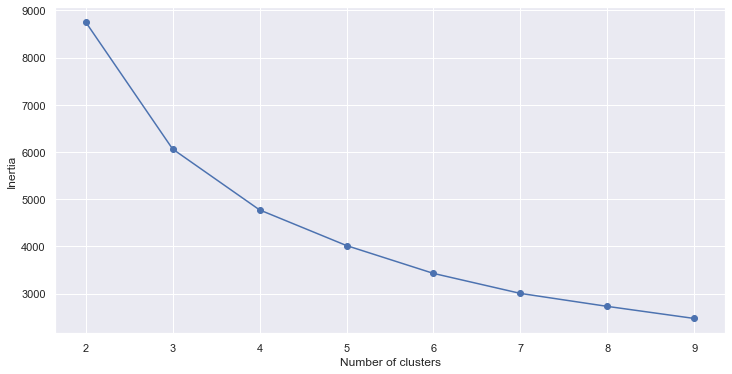

In [41]:
# Plot inertia for multiple cluster solutions against the number of clusters
# fitting multiple k-means algorithms and storing the values in an empty list
SSE = []
for cluster in range(2,10):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++')
    kmeans.fit(k_scaled)
    SSE.append(kmeans.inertia_)

# converting the results into a dataframe and plotting them
cust_df_frame = pd.DataFrame({'Cluster':range(2,10), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(cust_df_frame['Cluster'], cust_df_frame['SSE'], marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

In [49]:
# Defining the kmeans function with initialization as k-means++; # You want to cluster into 5 segments
knn_3 = KMeans(n_clusters = 3, init='k-means++')

# fitting the k means algorithm on scaled data
knn_3.fit(k_scaled)

KMeans(n_clusters=3)

In [54]:
knn3pred = knn_3.predict(k_scaled)

knn3result = pd.DataFrame(k_scaled)
knn3result['cluster'] = knn3pred
print(knn3result['cluster'].value_counts())

0    2365
2    1784
1     851
Name: cluster, dtype: int64


In [55]:
knn3result.head(3)

,TotalLastMonth,TotalTenure,CardItemsMonthly,cluster,cluster5_2
0,-0.292464,-0.672223,-1.526896,0,1
1,1.221465,1.114940,-1.526896,1,3
2,0.408357,0.120311,-0.347234,0,1


In [56]:
# Create a new data column cluster5_2 to incorporate a cluster indicator variable running from 1 to 5
knn3result['cluster'] = knn3result['cluster'] + 1
knn3result = knn3result.drop('cluster5_2',axis = 1)
knn3result.head(3)

,TotalLastMonth,TotalTenure,CardItemsMonthly,cluster
0,-0.292464,-0.672223,-1.526896,1
1,1.221465,1.114940,-1.526896,2
2,0.408357,0.120311,-0.347234,1


In [58]:
# Calculate silhouette_score
from sklearn.metrics import silhouette_score
print("The silhouette score of 3 clusters:",silhouette_score(knn3result, kmeans.labels_))

The silhouette score of 3 clusters: 0.3349266534340906


### Cluster Result Analysis

In [120]:
cust_df[['TotalLastMonth','CardItemsMonthly','TotalTenure']].describe()

,TotalLastMonth,CardItemsMonthly,TotalTenure
count,5000.00000,5000.00000,5000.000000
mean,64.10685,10.17740,1600.607440
std,51.65885,3.39114,2142.519996
min,2.85000,0.00000,0.000000
25%,26.70000,8.00000,220.025000
50%,49.72500,10.00000,766.200000
75%,87.30000,12.00000,2088.112500
max,590.40000,23.00000,21057.000000


In [108]:
#Binning TotalLastMonth:
cut_points = [26.7,49.7,87.3]
labels = ["<26.7",">26.7-49.7",">49.7-87.3",">87.3"]
cust_df["TotalLastMonth_Recoded"] = binning(cust_df["TotalLastMonth"], cut_points,labels)
print (pd.value_counts(cust_df["TotalLastMonth_Recoded"], sort=False))

#Binning CardItems:
cut_points = [8,10,12]
labels = ["<8",">8-10",">10-12",">12"]
cust_df["CardItems_Recoded"] = binning(cust_df["CardItemsMonthly"], cut_points,labels)
print (pd.value_counts(cust_df["CardItems_Recoded"], sort=False))

#Binning TotalTenure:
cut_points = [220,766,2088]
labels = ["0-220",">220-766",">766-2088",">2088"]
cust_df["TotalTenure_Recoded"] = binning(cust_df['TotalTenure'], cut_points,labels)
print (pd.value_counts(cust_df['TotalTenure_Recoded'], sort=False))

comdf = cust_df[["TotalLastMonth_Recoded","CardItems_Recoded","TotalTenure_Recoded"]]

[2.85, 26.7, 49.7, 87.3, 590.4]
<26.7         1258
>26.7-49.7    1242
>49.7-87.3    1251
>87.3         1249
Name: TotalLastMonth_Recoded, dtype: int64
[0, 8, 10, 12, 23]
<8        1573
>8-10     1177
>10-12    1098
>12       1152
Name: CardItems_Recoded, dtype: int64
[0.0, 220, 766, 2088, 21057.0]
0-220        1250
>220-766     1250
>766-2088    1249
>2088        1251
Name: TotalTenure_Recoded, dtype: int64


In [111]:
# Joining the clusters from kmeans to the original data used for clustering
knn_ALL = pd.DataFrame(pd.concat([knn3result,comdf], axis = 1))
knn_ALL.shape

# Using pandas crosstabs to create a cross tab of clusters by loan defaults
pd.crosstab(knn_ALL['cluster'],knn_ALL['TotalLastMonth_Recoded'],margins=True, normalize = 'columns')
pd.crosstab(knn_ALL['cluster'],knn_ALL['TotalTenure_Recoded'],margins=True, normalize = 'columns')
pd.crosstab(knn_ALL['cluster'],knn_ALL['CardItems_Recoded'],margins=True, normalize = 'columns')


(5000, 7)

TotalLastMonth_Recoded,<26.7,>26.7-49.7,>49.7-87.3,>87.3,All
cluster,,,,,
1,0.568362,0.545894,0.561151,0.216173,0.4730
2,0.000000,0.000000,0.006395,0.674940,0.1702
3,0.431638,0.454106,0.432454,0.108887,0.3568


TotalTenure_Recoded,0-220,>220-766,>766-2088,>2088,All
cluster,,,,,
1,0.5728,0.5528,0.555645,0.211031,0.4730
2,0.0000,0.0008,0.004003,0.675460,0.1702
3,0.4272,0.4464,0.440352,0.113509,0.3568


CardItems_Recoded,<8,>8-10,>10-12,>12,All
cluster,,,,,
1,0.871583,0.84452,0.000000,0.000000,0.4730
2,0.128417,0.15548,0.233151,0.182292,0.1702
3,0.000000,0.00000,0.766849,0.817708,0.3568


### Cluster Output:

Cluster 1:

is the cluster occupying 47.3% (about a half) of total customers, with the largest crowd paying less than $87.3 for Total Last Month Service, and total consumption less than 2088 over whole tenure. Moreover, cluster 1 people do not buy more than 10 items monthly. These customers have the least willing to buy new products.

Cluster 2:

17% (less than a quater) of all cases. It is the cluster for customers with the highest consumption amount. Cluster 2 cases occupy 67.49% of consumption over $87.3 the last month and 67.5% of payment larger than 2088 over total tenure. This cluster is the one for the most valuable customers to retain.

Cluster 3:

35.7% of all cases. Customers in this cluster tend to buy more items than others. However, their spent is close to cluster 1. Cluster 2 occupy 81.8% of cases buying more than 12 itmes monthly and 76.7% of cases buying more than 10 items monthly. Meanwhile people in cluster 2 has less cases consuming larger > $87.3 than cluster 1 and less cases totally paying >2088 than cluster 1. 

#### To encourage consumption

Cluster 2 is the most important cluster to analyze and then cluster 3. Cluster 1 should be put in the retention analysis.

### Clusters Description

Plot the boxplots of features of three clusters to see if there are important triggers for high consuming crowd. Outliers are not displayed because we are focusing on the general difference.

In [101]:
concdf = pd.DataFrame(edadf)
concdf['cluster'] = knn3result['cluster']
concdf.head(5)

,Region,TownSize,Gender,Age,EducationYears,UnionMember,EmploymentLength,Retired,HHIncome,DebtToIncomeRatio,...,JobCategory_Professional,JobCategory_Sales,JobCategory_Service,CarOwnership_-1,CarOwnership_Lease,CarOwnership_Own,CarBrand_-1,CarBrand_Domestic,CarBrand_Foreign,cluster
0,1,2.0,0.0,20,15,1,0,0,31000.0,11.1,...,1,0,0,0,0,1,0,1,0,1
1,5,5.0,1.0,22,17,0,0,0,15000.0,18.6,...,0,1,0,0,0,1,0,0,1,2
2,3,4.0,0.0,67,14,0,16,0,35000.0,9.9,...,0,1,0,0,0,1,0,0,1,1
3,4,3.0,1.0,23,16,0,0,0,20000.0,5.7,...,0,1,0,0,0,1,0,0,1,3
4,2,2.0,1.0,26,16,0,1,0,23000.0,1.7,...,0,1,0,0,1,0,0,0,1,1


In [127]:
edadf.columns

53

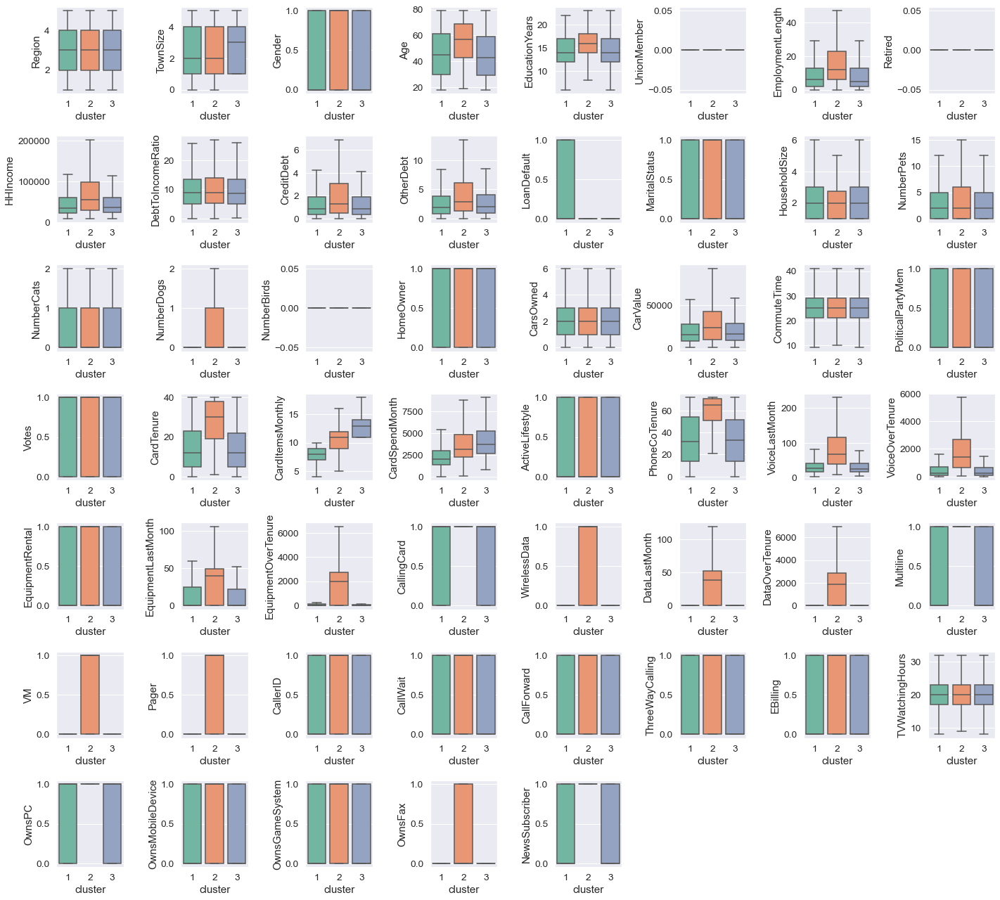

In [133]:
krecols = ['Region','TownSize','Gender','Age','EducationYears','UnionMember','EmploymentLength','Retired','HHIncome',
          'DebtToIncomeRatio','CreditDebt','OtherDebt', 'LoanDefault', 'MaritalStatus',
       'HouseholdSize', 'NumberPets', 'NumberCats', 'NumberDogs',
       'NumberBirds', 'HomeOwner', 'CarsOwned', 'CarValue', 'CommuteTime',
       'PoliticalPartyMem', 'Votes', 'CardTenure', 'CardItemsMonthly',
       'CardSpendMonth', 'ActiveLifestyle', 'PhoneCoTenure', 'VoiceLastMonth',
       'VoiceOverTenure', 'EquipmentRental', 'EquipmentLastMonth',
       'EquipmentOverTenure', 'CallingCard', 'WirelessData', 'DataLastMonth',
       'DataOverTenure', 'Multiline', 'VM', 'Pager', 'CallerID', 'CallWait',
       'CallForward', 'ThreeWayCalling', 'EBilling', 'TVWatchingHours',
       'OwnsPC', 'OwnsMobileDevice', 'OwnsGameSystem', 'OwnsFax',
       'NewsSubscriber']
count= 0
fig = plt.figure(figsize=(20, 20))

for i in krecols:    
    count +=1
    ax = fig.add_subplot(8, 8, count)
    ax = sns.boxplot( x=concdf["cluster"], y=concdf[i],palette = 'Set2',showfliers=False)
    plt.tight_layout()
    
plt.show()

## Analysis

- From the plots above, following features do not distinct between 3 clusters:

Region, TownSize, Gender, UnionMember, Retired, DebtToIncomeRatio, MaritalStatus, HouseholdSize, NumberPets, NumberCats, NumberBirds, HomeOwner, CarsOwned, CommuteTime, PoliticalPartyMem, Votes, ActiveLifestyle,EquipmentRental,CallerID,CallWait,CallForward,ThreeWayCalling,EBilling,TVWatchingHours,OwnsMobileDevice, wnsGameSystem.

- Following are features significantly differring:

Cluster 2 have more and cluster 1&3 have none or less:

OwnsFax, NewsSubscriber, OwnsPC, Pager, VM, Multiline, WirelessData, CallingCard, EquipmentLastMonth, VoiceLastMonth, PhoneCoTenure, CarValue, NumberDogs, CreditDebt, OtherDebit, HHIncome, EmploymentLength, EducationYears, Age.

Cluster 2 have less than other clusters:

HouseholdSize

- Significant Difference between Cluster 1&3:

Cluster 1 has True LoanDefault while cluster 3 does not has.


### Category features analysis:

All JobCategory and CarOwnership and CarBrand features have similar distribution among three clusters. Despite the 'JobCategory_Sales', cluster 2 has most False value, while other 2 clusters has more cases with a sales job.

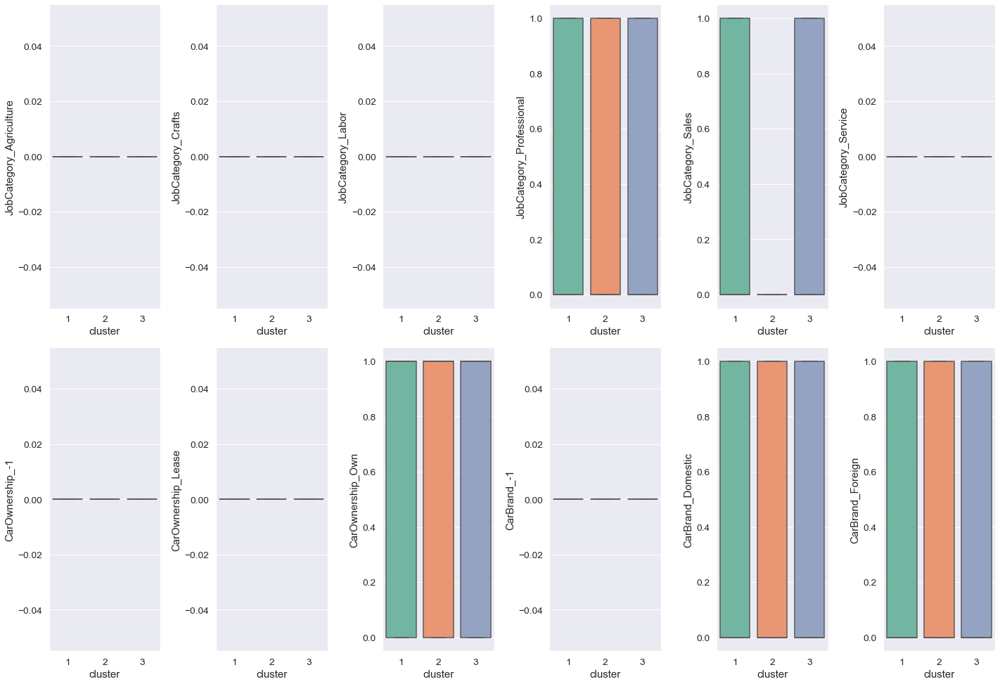

In [132]:
catecols = ['JobCategory_Agriculture', 'JobCategory_Crafts',
       'JobCategory_Labor', 'JobCategory_Professional', 'JobCategory_Sales',
       'JobCategory_Service', 'CarOwnership_-1', 'CarOwnership_Lease',
       'CarOwnership_Own', 'CarBrand_-1', 'CarBrand_Domestic',
       'CarBrand_Foreign']

count= 0
fig = plt.figure(figsize=(20, 20))

for i in catecols:    
    count +=1
    ax = fig.add_subplot(3, 6, count)
    ax = sns.boxplot( x=concdf["cluster"], y=concdf[i],palette = 'Set2',showfliers=False)
    plt.tight_layout()
    
plt.show()